**Enhancement of Image**

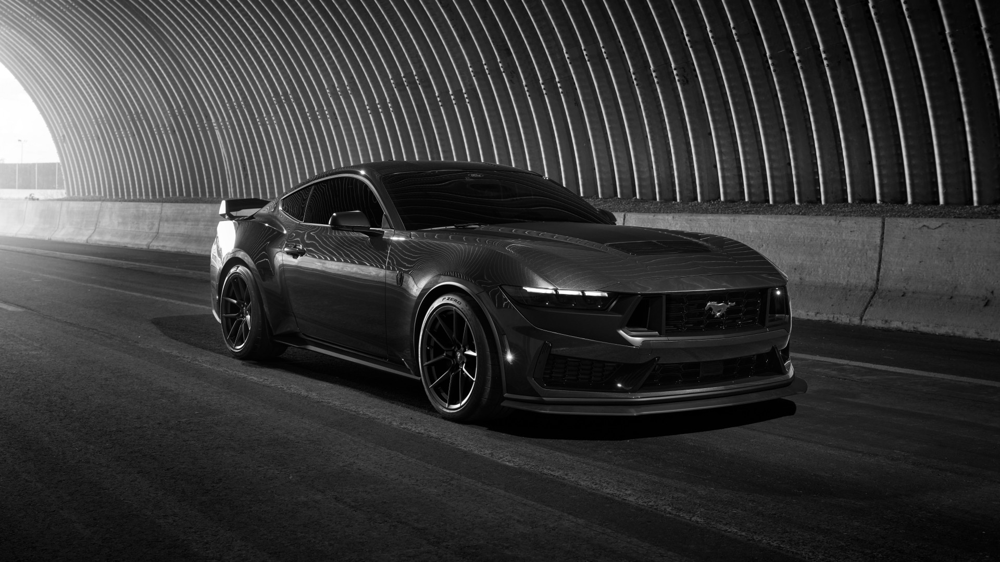

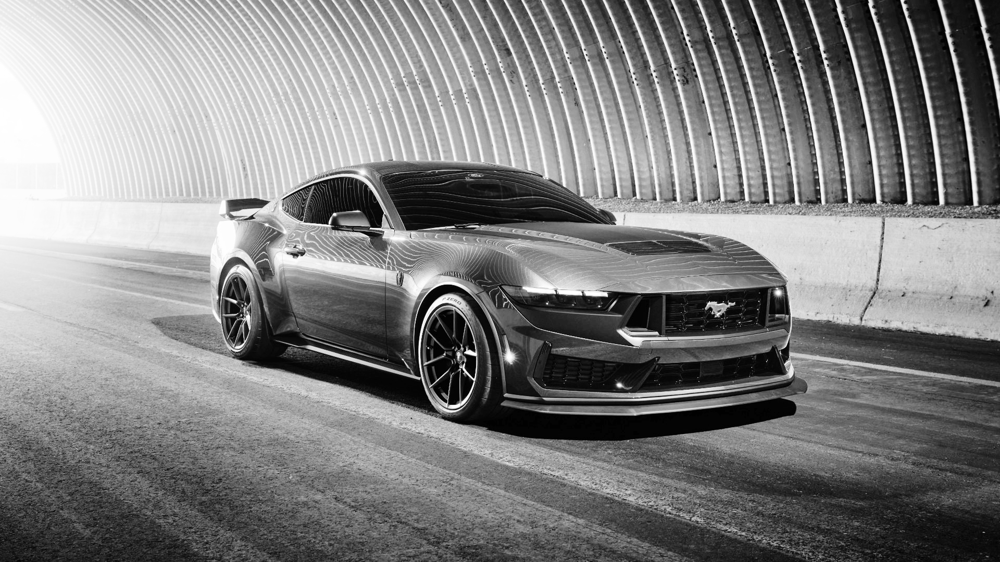

Original image histogram:
[10149 23183  9284 11290 13616 16231 16507 15176 14747 15549 16321 16847
 18129 20035 22013 24080 26295 28191 30303 31685 33121 33713 34415 34864
 35521 35626 36422 36606 36216 36048 35374 34520 33758 32332 31864 30317
 29438 28154 26999 26121 25210 24693 23669 22286 21962 21483 20845 20369
 20133 19971 20079 19611 19541 19145 18373 18181 17662 17189 16687 16333
 15485 14522 13945 13189 12774 12169 11967 11908 11766 11862 11746 11508
 11237 11192 11162 10432  9952  9240  8836  8394  7822  7432  6851  6580
  6021  5803  5492  5362  5099  4986  4990  5075  4805  4945  4802  4757
  4576  4601  4315  4266  4185  4067  3942  3638  3448  3292  3339  3287
  3206  3088  2996  2916  2862  2768  2853  2725  2697  2565  2668  2586
  2632  2666  2509  2501  2584  2480  2501  2479  2512  2560  2679  2704
  2623  2648  2610  2602  2515  2394  2297  2283  2205  2190  2231  2208
  2127  2115  2262  2183  2263  2304  2318  2133  2163  2217  2118  2179
  2214  2199  2166  2213 

In [7]:
#1.1
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

#image loaded
image = cv2.imread("ford.jpg", cv2.IMREAD_GRAYSCALE)

#histogram
histogram = np.zeros(256, dtype=int)
for i in range(image.shape[0]):
    for j in range(image.shape[1]):
        histogram[image[i, j]] += 1

#cummulative
cumulative_histogram = np.cumsum(histogram)

# Normalizing
normalized_cumulative_histogram = cumulative_histogram / float(np.sum(histogram))

# Equaliziation
equalized_image = np.zeros(image.shape, dtype=np.uint8)
for i in range(image.shape[0]):
    for j in range(image.shape[1]):
        equalized_image[i, j] = int(255 * normalized_cumulative_histogram[image[i, j]])

cv2_imshow(image)
cv2_imshow(equalized_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

print("Original image histogram:")
print(histogram)
print("Equalized image histogram:")
equalized_histogram = np.histogram(equalized_image, bins=256, range=(0, 256))[0]
print(equalized_histogram)

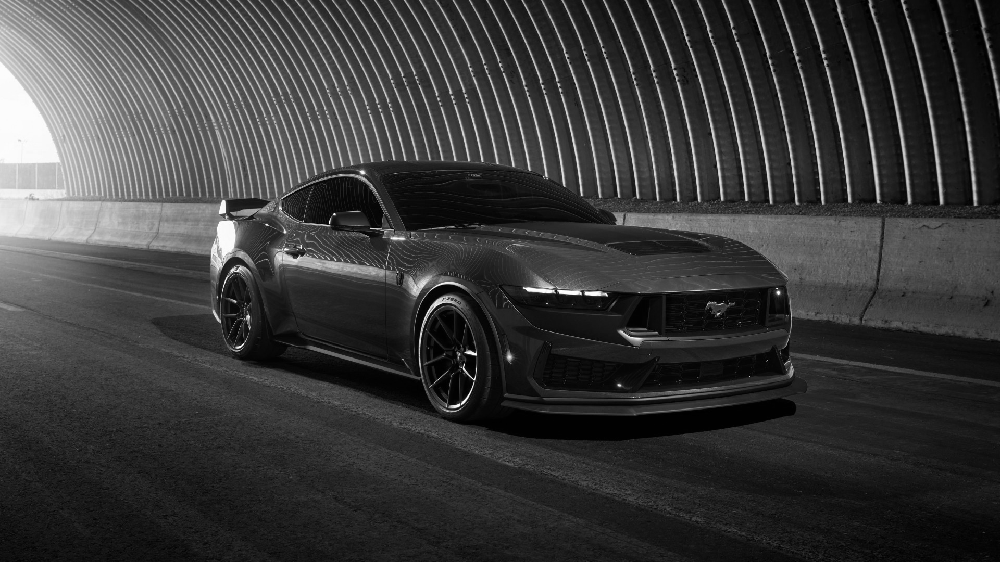

In [9]:
#1.2
import numpy as np

def rgb2gray(image):
  r,g,b = image[:,:,0],image[:,:,1],image[:,:,2]
  gray_image = 0.29*r+0.5870*g+0.1140 * b
  return gray_image

image = cv2.imread("ford.jpg")

grayscale_image = rgb2gray(image)
cv2_imshow(grayscale_image)

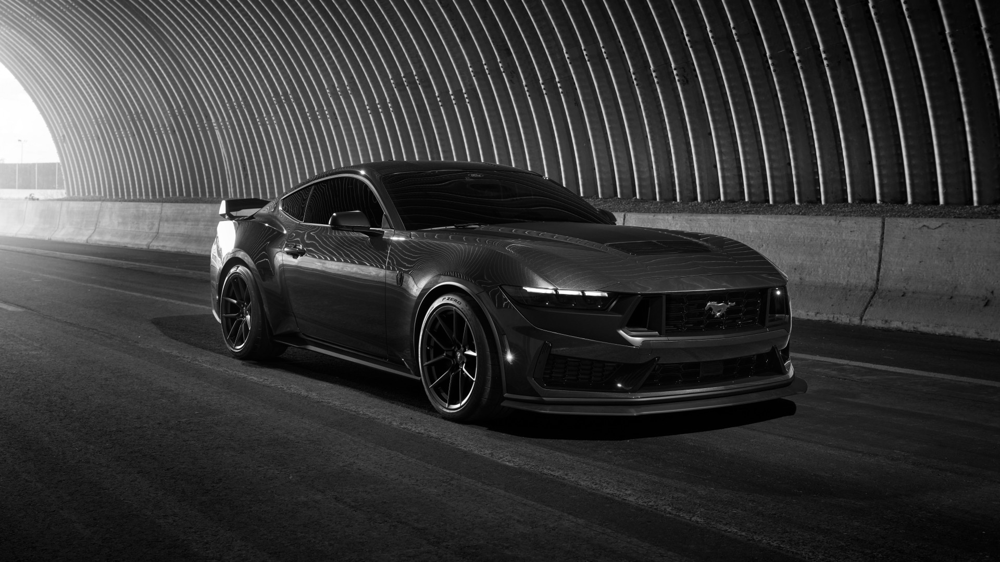

In [20]:
#Using Library
import cv2
from google.colab.patches import cv2_imshow
image = cv2.imread("ford.jpg")
gray_cv2 = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Display the grayscale ima
cv2_imshow(gray_cv2)

The Images after conversion using library and the formula both have good result and there is no difference

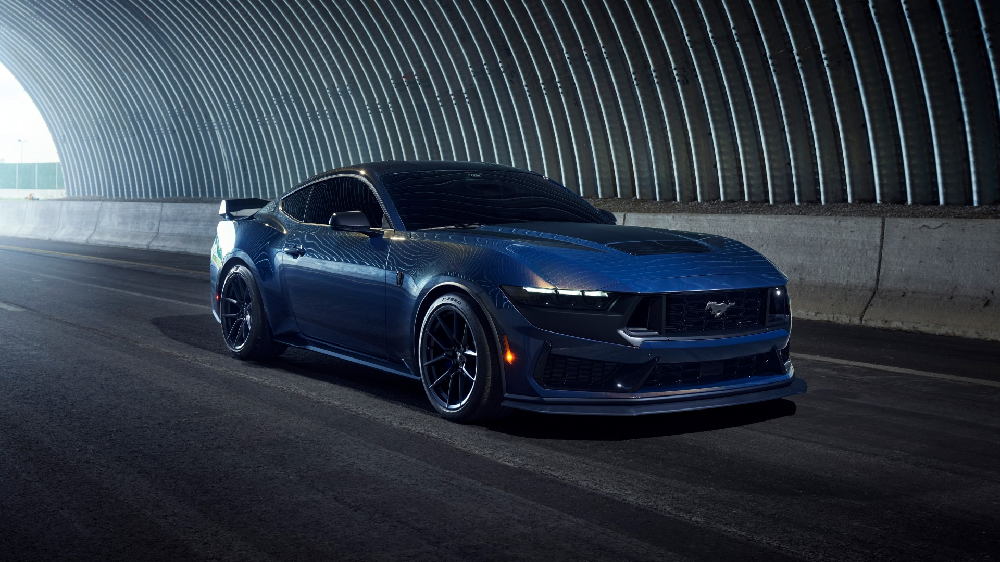

Resized to {resolution[0]}x{resolution[1]}


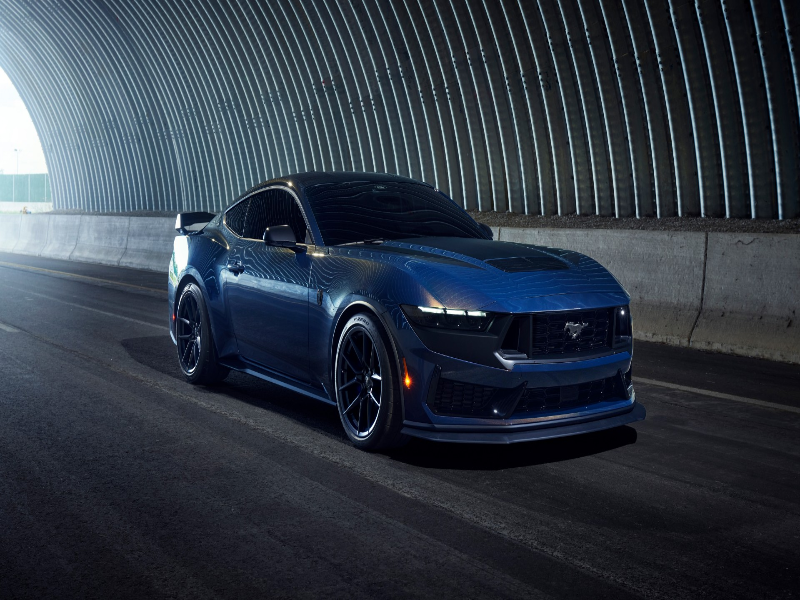

Resized to {resolution[0]}x{resolution[1]}


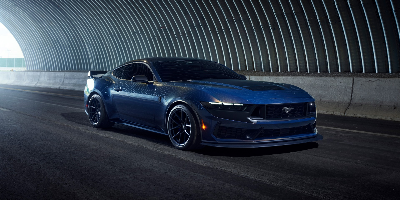

Resized to {resolution[0]}x{resolution[1]}


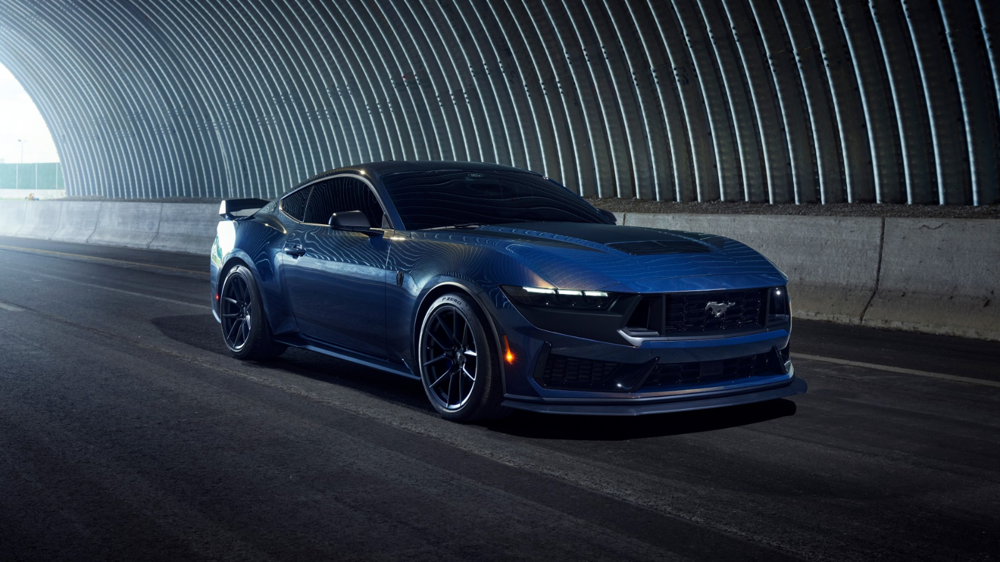

Resized to {resolution[0]}x{resolution[1]}


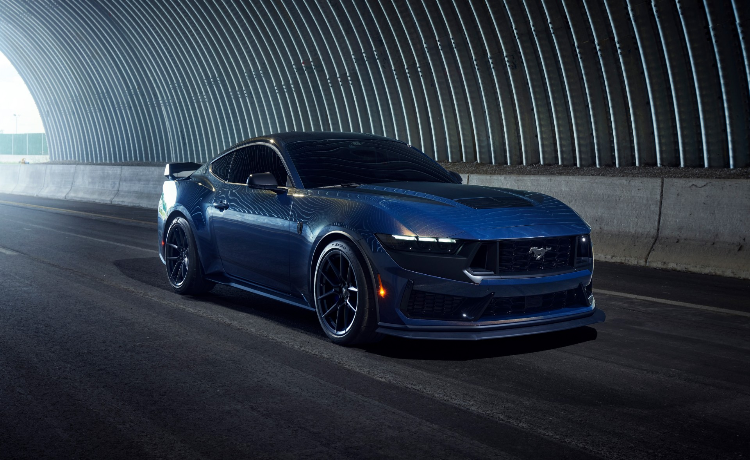

Resized to {resolution[0]}x{resolution[1]}


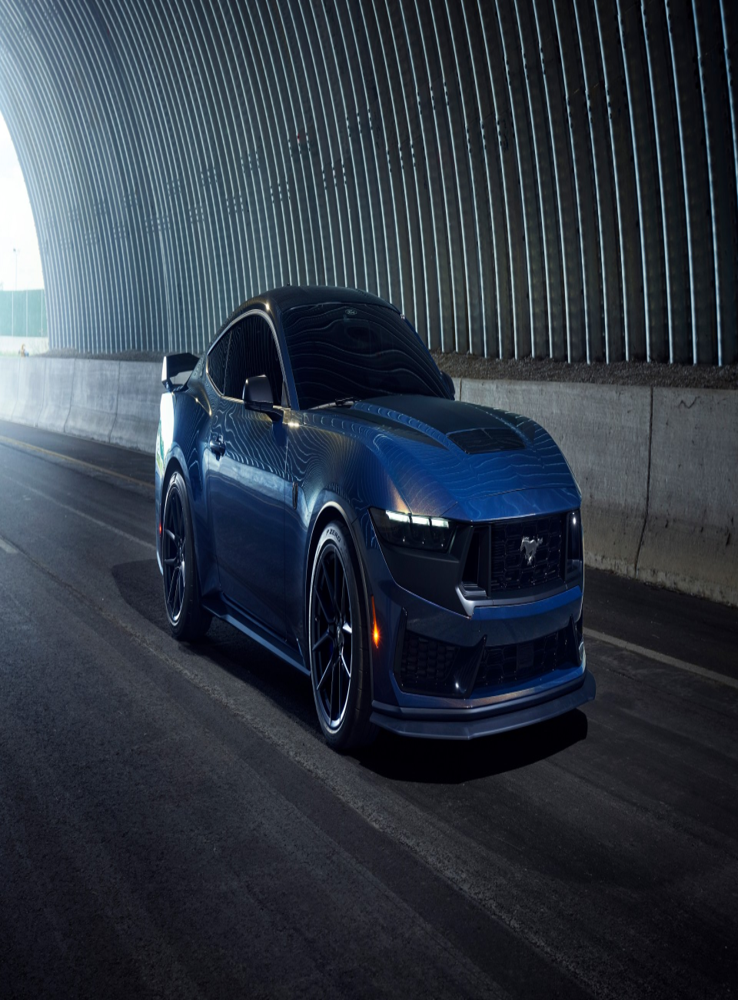

In [29]:
#1.3
import cv2


original_image = image
current_height, current_width, _ = original_image.shape
resolutions = [(800, 600), (400, 200), (1600, 900), (750, 460), (960, 1300)]

resized_images = []

for target_width, target_height in resolutions:

    scale_x = target_width / current_width
    scale_y = target_height / current_height
    resized_image = cv2.resize(original_image, (target_width, target_height), interpolation=cv2.INTER_LINEAR)
    resized_images.append(resized_image)

cv2_imshow(original_image)

for i, resolution in enumerate(resolutions):
    print("Resized to {resolution[0]}x{resolution[1]}")
    cv2_imshow(resized_images[i])


Resultant pixel at (10, 10): 344.88885498046875
Original Image


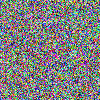

Blurred Image


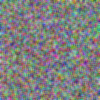

In [32]:
#1.4
import cv2
import numpy as np

kernel = np.ones((3, 3), np.float32) / 9


image_height, image_width = 100, 100
kernel_height, kernel_width = kernel.shape
dummy_image = np.random.randint(0, 256, (image_height, image_width, 3), dtype=np.uint8)
result_image = cv2.filter2D(dummy_image, -1, kernel)


x, y = 10, 10
region = dummy_image[y:y + kernel_height, x:x + kernel_width]
resultant_pixel = np.sum(region * kernel)


print(f"Resultant pixel at ({x}, {y}): {resultant_pixel}")


print("Original Image")
cv2_imshow(dummy_image)
print("Blurred Image")
cv2_imshow(result_image)



Resultant pixel at (10, 10): 419.1111145019531
Original Image


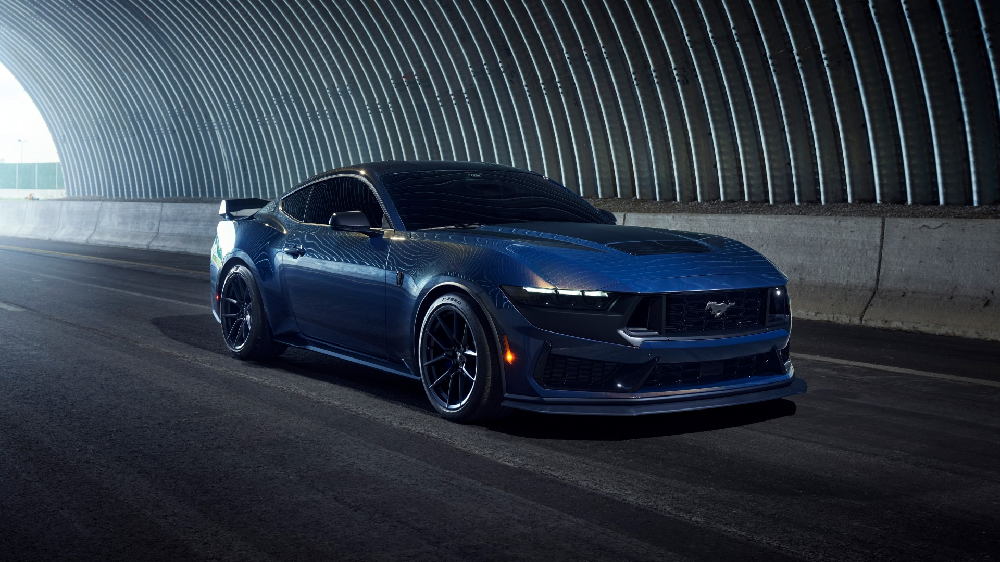

Blurred Image


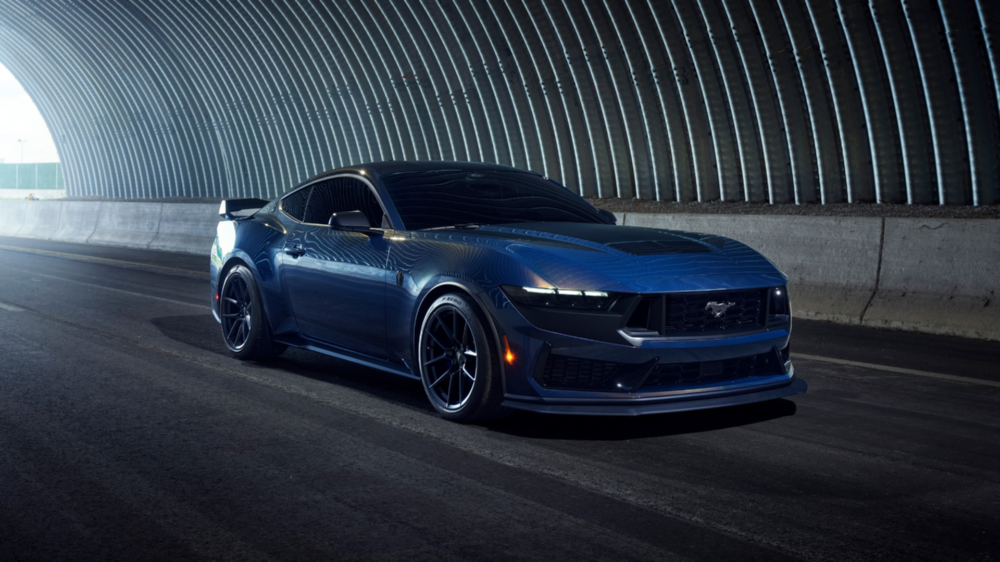

In [35]:
import cv2
import numpy as np

image_height, image_width, _ = image.shape
kernel = np.ones((3, 3), np.float32) / 9

kernel_height, kernel_width = kernel.shape

result_image = cv2.filter2D(image, -1, kernel)
x, y = 10, 10
region = image[y:y + kernel_height, x:x + kernel_width]
resultant_pixel = np.sum(region * kernel)


print(f"Resultant pixel at ({x}, {y}): {resultant_pixel}")

# Display the original and blurred images
print("Original Image")
cv2_imshow( image)
print("Blurred Image")
cv2_imshow(result_image)



In [41]:
#1.5
import cv2
import numpy as np

# Load the main image and the template image (dummy image for demonstration)
main_image = image
template_image = grayscale_image
# Get the dimensions of the images
main_height, main_width,_= main_image.shape
template_height, template_width = template_image.shape

# Normalize both images by dividing by 255.0
main_image_norm = main_image / 255.0
template_image_norm = template_image / 255.0

# Initialize variables to keep track of the maximum correlation value and its location
max_correlation_value = -1
max_correlation_location = (0, 0)

# Perform cross-correlation manually
for y in range(main_height - template_height + 1):
    for x in range(main_width - template_width + 1):
        # Extract the region of interest (ROI) from the main image
        roi = main_image_norm[y:y + template_height, x:x + template_width]

        # Calculate the correlation between the ROI and the template
        correlation = np.sum(roi * template_image_norm)

        # Check if this correlation value is greater than the current maximum
        if correlation > max_correlation_value:
            max_correlation_value = correlation
            max_correlation_location = (x, y)

# Draw a rectangle to highlight the matched region in the original image
matched_image = main_image.copy()
cv2.rectangle(matched_image, max_correlation_location, (max_correlation_location[0] + template_width, max_correlation_location[1] + template_height), 255, 2)

# Show the original image, template image, and the matched region
cv2.imshow("Original Image", main_image)
cv2.imshow("Template Image", template_image)
cv2.imshow("Matched Region", matched_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

# Print the maximum correlation value and its location
print(f"Maximum Correlation Value: {max_correlation_value}")
print(f"Location of Maximum Correlation: {max_correlation_location}")


ValueError: ignored